In [114]:
import numpy as np
import pandas as p
import seaborn as s
import matplotlib.pyplot as py
import matplotlib.cm as cm
%matplotlib inline
from sklearn.cluster import KMeans
from sklearn.ensemble import IsolationForest
from sklearn.metrics import silhouette_score,silhouette_samples
import warnings
warnings.filterwarnings("ignore")

In [115]:
df = p.read_csv('sensor.csv',infer_datetime_format=True,index_col=False)

In [116]:
df.head()

,Unnamed: 0,timestamp,sensor_00,sensor_01,sensor_02,sensor_03,sensor_04,sensor_05,sensor_06,sensor_07,...,sensor_43,sensor_44,sensor_45,sensor_46,sensor_47,sensor_48,sensor_49,sensor_50,sensor_51,machine_status
0,0,01-04-2018 00:00,2.465394,47.09201,53.2118,46.310760,634.3750,76.45975,13.41146,16.13136,...,41.92708,39.641200,65.68287,50.92593,38.194440,157.9861,67.70834,243.0556,201.3889,NORMAL
1,1,01-04-2018 00:01,2.465394,47.09201,53.2118,46.310760,634.3750,76.45975,13.41146,16.13136,...,41.92708,39.641200,65.68287,50.92593,38.194440,157.9861,67.70834,243.0556,201.3889,NORMAL
2,2,01-04-2018 00:02,2.444734,47.35243,53.2118,46.397570,638.8889,73.54598,13.32465,16.03733,...,41.66666,39.351852,65.39352,51.21528,38.194443,155.9606,67.12963,241.3194,203.7037,NORMAL
3,3,01-04-2018 00:03,2.460474,47.09201,53.1684,46.397568,628.1250,76.98898,13.31742,16.24711,...,40.88541,39.062500,64.81481,51.21528,38.194440,155.9606,66.84028,240.4514,203.1250,NORMAL
4,4,01-04-2018 00:04,2.445718,47.13541,53.2118,46.397568,636.4583,76.58897,13.35359,16.21094,...,41.40625,38.773150,65.10416,51.79398,38.773150,158.2755,66.55093,242.1875,201.3889,NORMAL


In [117]:
df['timestamp'] = p.to_datetime(df['timestamp'])

In [118]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 220320 entries, 0 to 220319
Data columns (total 55 columns):
 #   Column          Non-Null Count   Dtype         
---  ------          --------------   -----         
 0   Unnamed: 0      220320 non-null  int64         
 1   timestamp       220320 non-null  datetime64[ns]
 2   sensor_00       210112 non-null  float64       
 3   sensor_01       219951 non-null  float64       
 4   sensor_02       220301 non-null  float64       
 5   sensor_03       220301 non-null  float64       
 6   sensor_04       220301 non-null  float64       
 7   sensor_05       220301 non-null  float64       
 8   sensor_06       215522 non-null  float64       
 9   sensor_07       214869 non-null  float64       
 10  sensor_08       215213 non-null  float64       
 11  sensor_09       215725 non-null  float64       
 12  sensor_10       220301 non-null  float64       
 13  sensor_11       220301 non-null  float64       
 14  sensor_12       220301 non-null  flo

In [119]:
df = df.drop(['sensor_15','Unnamed: 0'],axis=1) # as sensor_15 contains 0 values

In [120]:
df.isna().sum()

timestamp             0
sensor_00         10208
sensor_01           369
sensor_02            19
sensor_03            19
sensor_04            19
sensor_05            19
sensor_06          4798
sensor_07          5451
sensor_08          5107
sensor_09          4595
sensor_10            19
sensor_11            19
sensor_12            19
sensor_13            19
sensor_14            21
sensor_16            31
sensor_17            46
sensor_18            46
sensor_19            16
sensor_20            16
sensor_21            16
sensor_22            41
sensor_23            16
sensor_24            16
sensor_25            36
sensor_26            20
sensor_27            16
sensor_28            16
sensor_29            72
sensor_30           261
sensor_31            16
sensor_32            68
sensor_33            16
sensor_34            16
sensor_35            16
sensor_36            16
sensor_37            16
sensor_38            27
sensor_39            27
sensor_40            27
sensor_41       

In [121]:
df[df['sensor_12'].isna()].index

Int64Index([ 25112,  38508,  38509,  38510,  38511,  38512,  38513,  38514,
             38515, 134855, 134873, 136197, 136265, 145992, 145993, 145994,
            220008, 220009, 220010],
           dtype='int64')

In [122]:
df[df['sensor_11'].isna()].index

Int64Index([ 25112,  38508,  38509,  38510,  38511,  38512,  38513,  38514,
             38515, 134855, 134873, 136197, 136265, 145992, 145993, 145994,
            220008, 220009, 220010],
           dtype='int64')

In [123]:
df[df['sensor_13'].isna()].index

Int64Index([ 25112,  38508,  38509,  38510,  38511,  38512,  38513,  38514,
             38515, 134855, 134873, 136197, 136265, 145992, 145993, 145994,
            220008, 220009, 220010],
           dtype='int64')

In [124]:
df[df['sensor_02'].isna()].index

Int64Index([ 25112,  38508,  38509,  38510,  38511,  38512,  38513,  38514,
             38515, 134855, 134873, 136197, 136265, 145992, 145993, 145994,
            220008, 220009, 220010],
           dtype='int64')

In [125]:
# df[df['sensor_03'].isna()].index

In [126]:
# df[df['sensor_04'].isna()].index

In [127]:
df[df['sensor_05'].isna()].index

Int64Index([ 25112,  38508,  38509,  38510,  38511,  38512,  38513,  38514,
             38515, 134855, 134873, 136197, 136265, 145992, 145993, 145994,
            220008, 220009, 220010],
           dtype='int64')

In [128]:
# df[df['sensor_10'].isna()].index

In [129]:
df[df['sensor_37'].isna()].index

Int64Index([ 38508,  38509,  38510,  38511,  38512,  38513,  38514,  38515,
             48522,  48564, 113141, 145992, 145993, 145994, 146035, 147679],
           dtype='int64')

In [130]:
df['sensor_37']

0          90.32386
1          90.32386
2          93.90508
3         101.04060
4         101.70380
            ...    
220315      0.00000
220316      0.00000
220317      0.00000
220318      0.00000
220319      0.00000
Name: sensor_37, Length: 220320, dtype: float64

In [131]:
df[df['sensor_19'].isna()].index

Int64Index([ 38508,  38509,  38510,  38511,  38512,  38513,  38514,  38515,
             48522,  48564, 113141, 145992, 145993, 145994, 146035, 147679],
           dtype='int64')

In [132]:
# df[df['sensor_35'].isna()].index

In [133]:
df[df['sensor_49'].isna()].index

Int64Index([ 25112,  38508,  38509,  38510,  38511,  38512,  38513,  38514,
             38515,  87832,  87833,  87834,  87835,  87836,  87837,  87838,
             87839, 134855, 134873, 136197, 136265, 145992, 145993, 145994,
            220008, 220009, 220010],
           dtype='int64')

In [134]:
# df[df['sensor_41'].isna()].index

In [135]:
# df[df['sensor_18'].isna()].index

In [136]:
df.duplicated().sum()

0

In [137]:
df = df.drop_duplicates()

In [138]:
df.describe()

,sensor_00,sensor_01,sensor_02,sensor_03,sensor_04,sensor_05,sensor_06,sensor_07,sensor_08,sensor_09,...,sensor_42,sensor_43,sensor_44,sensor_45,sensor_46,sensor_47,sensor_48,sensor_49,sensor_50,sensor_51
count,210112.000000,219951.000000,220301.000000,220301.000000,220301.000000,220301.000000,215522.000000,214869.000000,215213.000000,215725.000000,...,220293.000000,220293.000000,220293.000000,220293.000000,220293.000000,220293.000000,220293.000000,220293.000000,143303.000000,204937.000000
mean,2.372221,47.591611,50.867392,43.752481,590.673936,73.396414,13.501537,15.843152,15.200721,14.799210,...,35.453455,43.879591,42.656877,43.094984,48.018585,44.340903,150.889044,57.119968,183.049260,202.699667
std,0.412227,3.296666,3.666820,2.418887,144.023912,17.298247,2.163736,2.201155,2.037390,2.091963,...,10.259521,11.044404,11.576355,12.837520,15.641284,10.442437,82.244957,19.143598,65.258650,109.588607
min,0.000000,0.000000,33.159720,31.640620,2.798032,0.000000,0.014468,0.000000,0.028935,0.000000,...,22.135416,24.479166,25.752316,26.331018,26.331018,27.199070,26.331018,26.620370,27.488426,27.777779
25%,2.438831,46.310760,50.390620,42.838539,626.620400,69.976260,13.346350,15.907120,15.183740,15.053530,...,32.812500,39.583330,36.747684,36.747684,40.509258,39.062500,83.912030,47.743060,167.534700,179.108800
50%,2.456539,48.133678,51.649300,44.227428,632.638916,75.576790,13.642940,16.167530,15.494790,15.082470,...,35.156250,42.968750,40.509260,40.219910,44.849540,42.534720,138.020800,52.662040,193.865700,197.338000
75%,2.499826,49.479160,52.777770,45.312500,637.615723,80.912150,14.539930,16.427950,15.697340,15.118630,...,36.979164,46.614580,45.138890,44.849540,51.215280,46.585650,208.333300,60.763890,219.907400,216.724500
max,2.549016,56.727430,56.032990,48.220490,800.000000,99.999880,22.251160,23.596640,24.348960,25.000000,...,374.218800,408.593700,1000.000000,320.312500,370.370400,303.530100,561.632000,464.409700,1000.000000,1000.000000


In [139]:
index = [38508,38509,38510,38511,38512,38513,38514,38515,145992,145993,145994] #I have checked for mostly column it has null values

In [140]:
df = df.drop(index=index)

In [141]:
df[df['sensor_18'].isna()].index

Int64Index([ 48522,  48564, 113141, 125640, 125641, 125642, 125643, 125644,
            125645, 125646, 125647, 125648, 125649, 125650, 125651, 125652,
            125653, 125654, 127320, 127321, 127322, 127323, 127324, 127325,
            127326, 127327, 127328, 127329, 127330, 127331, 127332, 127333,
            127334, 146035, 147679],
           dtype='int64')

In [142]:
df = df.set_index('timestamp',drop=True)

# HANDLING MISSING VALUES

In [143]:
def impute_nan(df,variable):
    median = df[variable].median()
    df[variable] = df[variable].fillna(median)

In [144]:
null_columns = df.columns[df.isnull().any()].tolist()

In [145]:
for columns in null_columns:
    impute_nan(df,columns)

# PLOTS

In [146]:
df1 = df.drop(['machine_status'], axis=1)
names=df1.columns

<Figure size 1000x300 with 0 Axes>

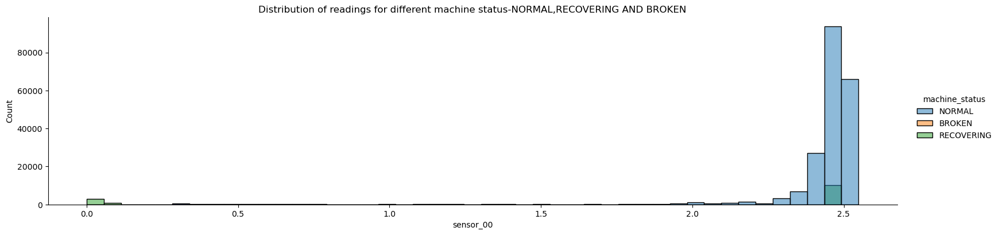

<Figure size 1000x300 with 0 Axes>

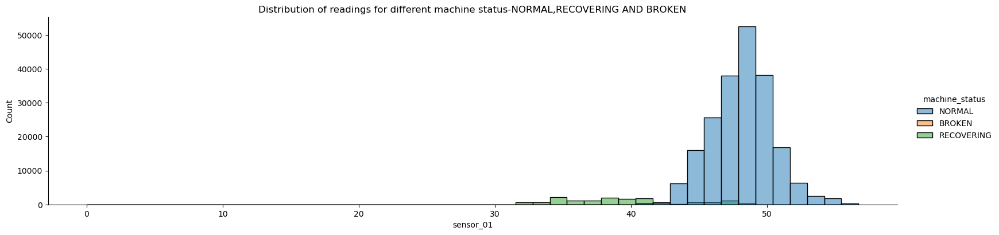

<Figure size 1000x300 with 0 Axes>

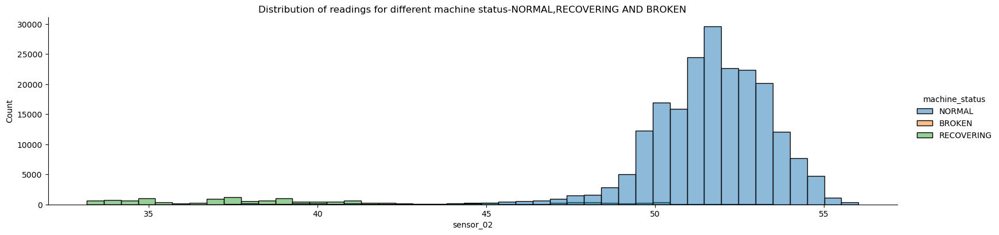

<Figure size 1000x300 with 0 Axes>

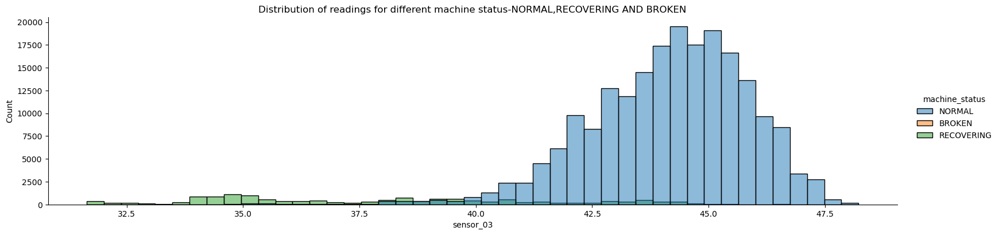

<Figure size 1000x300 with 0 Axes>

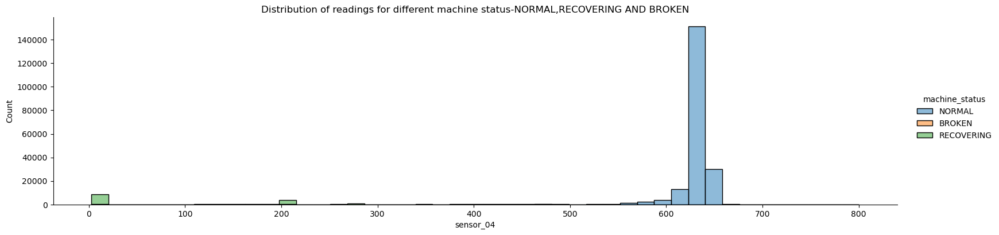

<Figure size 1000x300 with 0 Axes>

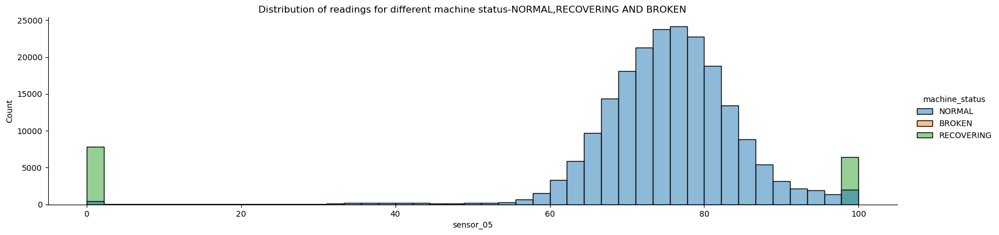

<Figure size 1000x300 with 0 Axes>

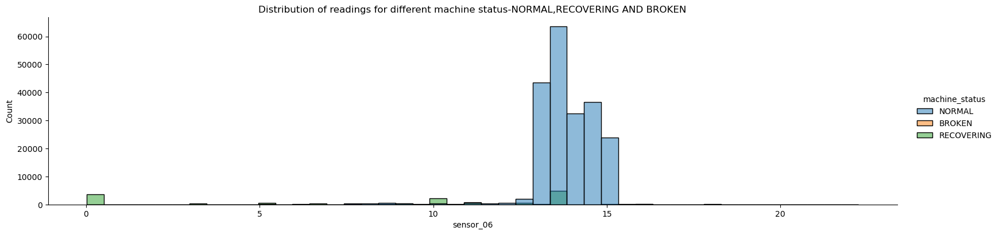

<Figure size 1000x300 with 0 Axes>

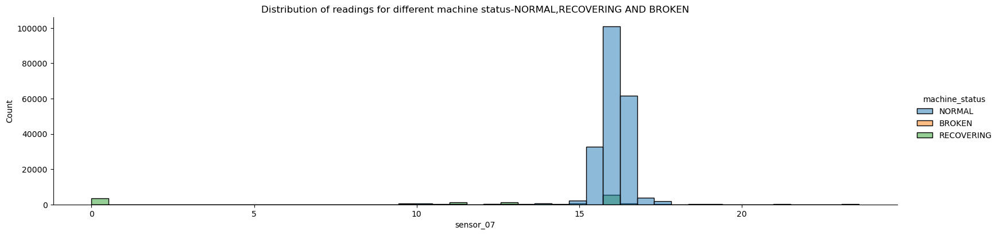

<Figure size 1000x300 with 0 Axes>

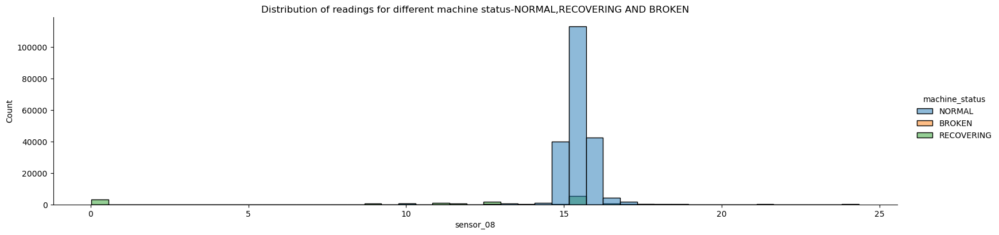

<Figure size 1000x300 with 0 Axes>

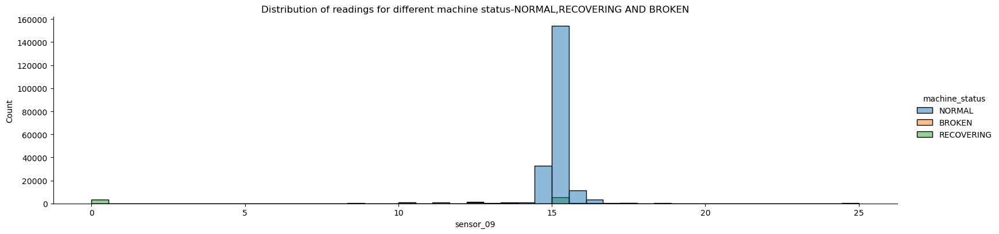

<Figure size 1000x300 with 0 Axes>

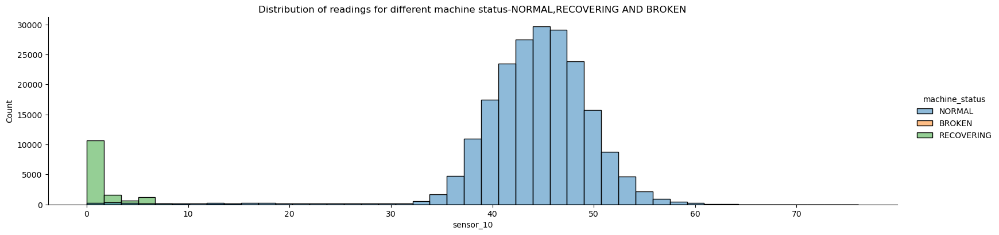

<Figure size 1000x300 with 0 Axes>

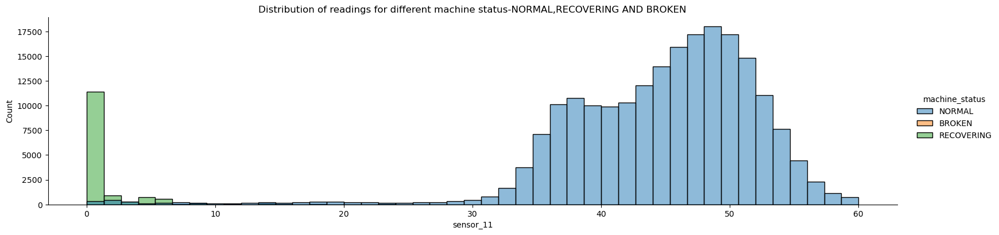

<Figure size 1000x300 with 0 Axes>

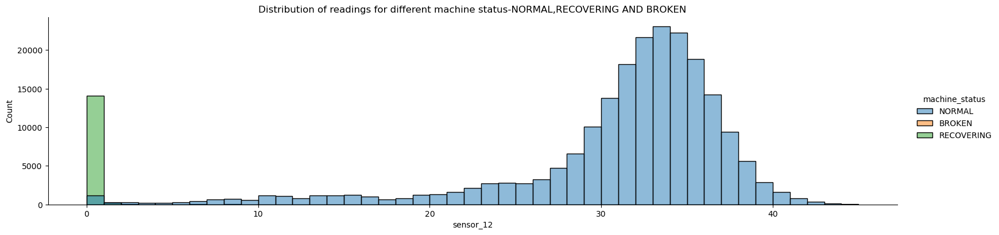

<Figure size 1000x300 with 0 Axes>

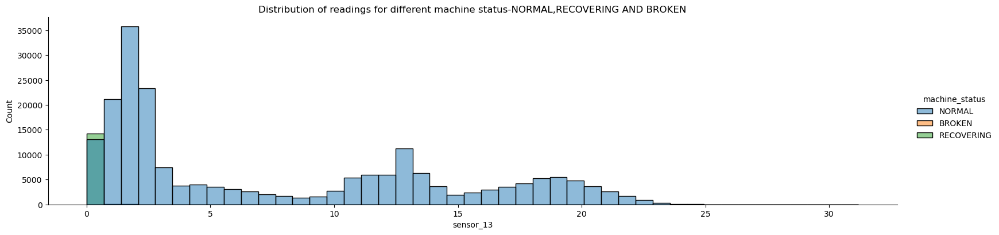

<Figure size 1000x300 with 0 Axes>

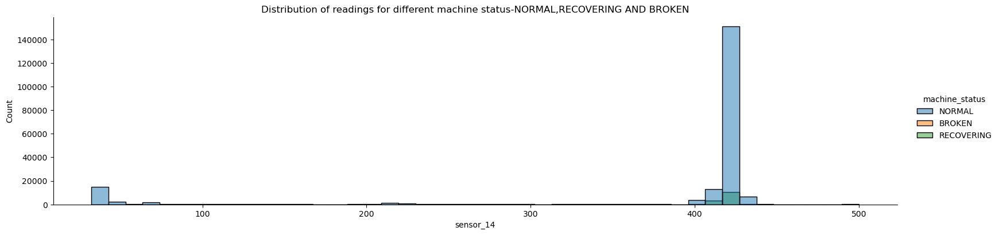

<Figure size 1000x300 with 0 Axes>

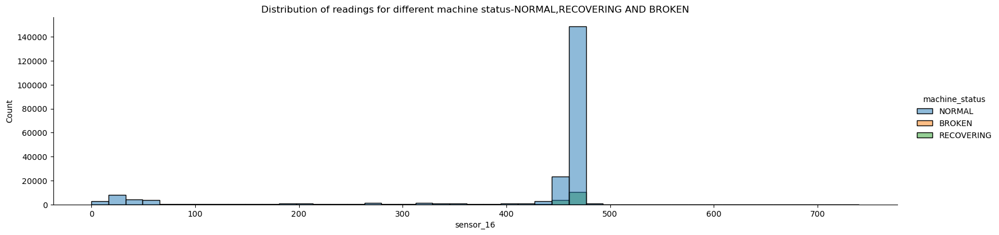

<Figure size 1000x300 with 0 Axes>

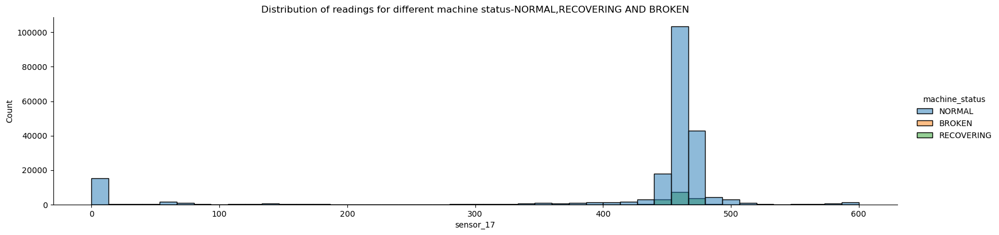

<Figure size 1000x300 with 0 Axes>

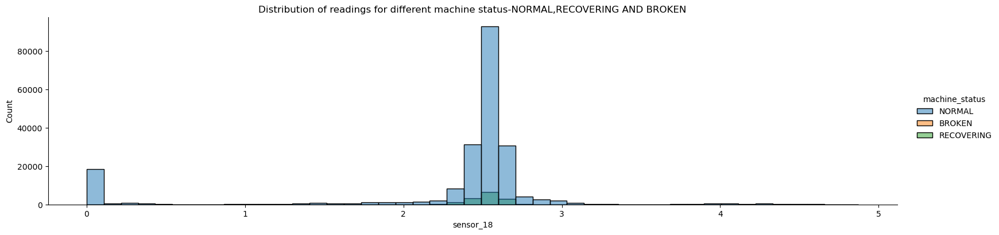

<Figure size 1000x300 with 0 Axes>

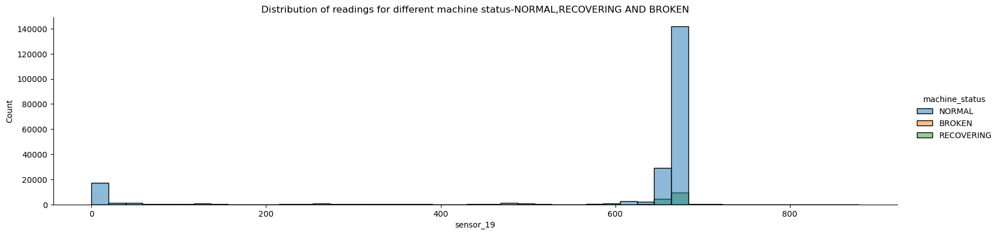

<Figure size 1000x300 with 0 Axes>

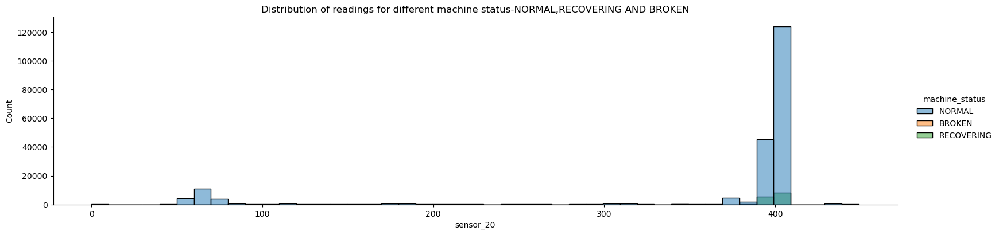

<Figure size 1000x300 with 0 Axes>

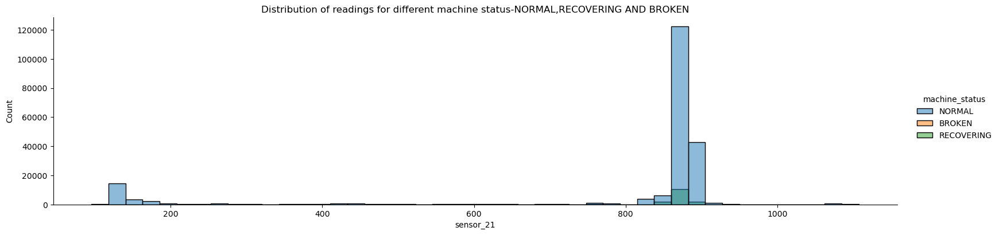

<Figure size 1000x300 with 0 Axes>

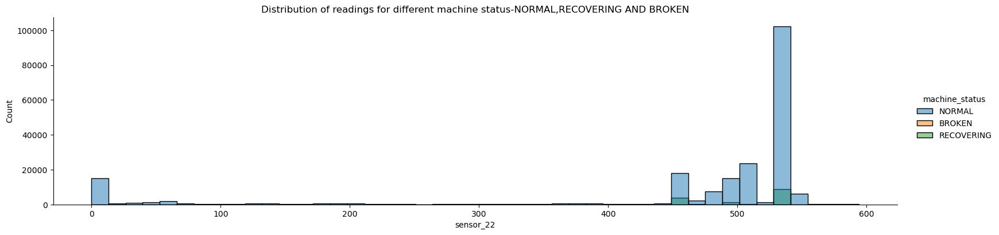

<Figure size 1000x300 with 0 Axes>

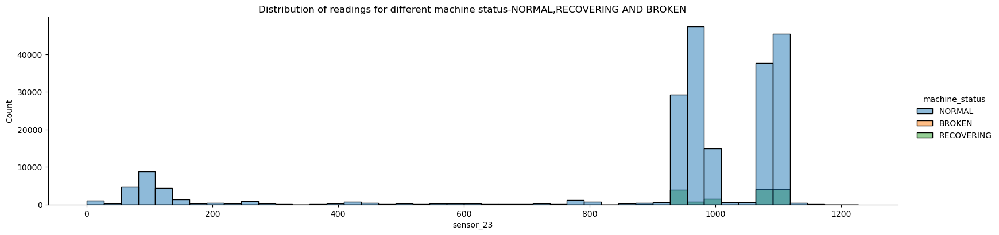

<Figure size 1000x300 with 0 Axes>

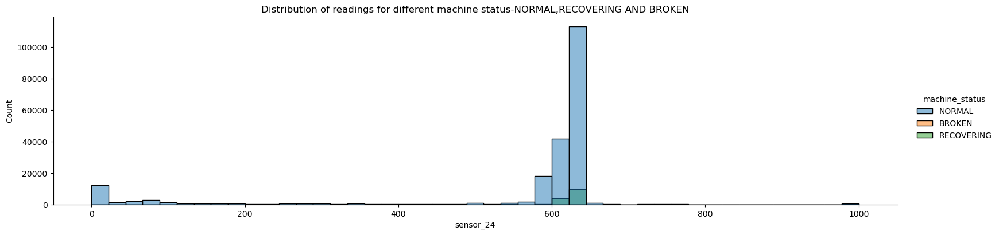

<Figure size 1000x300 with 0 Axes>

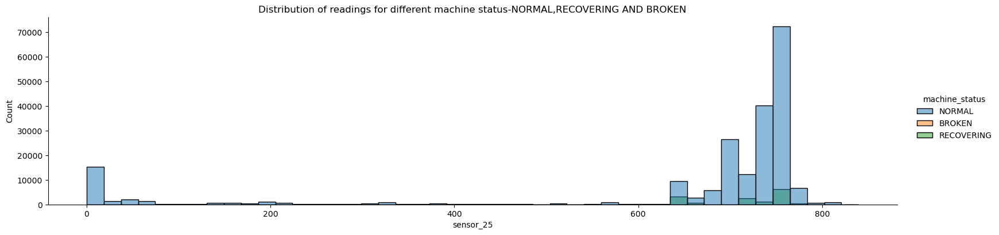

<Figure size 1000x300 with 0 Axes>

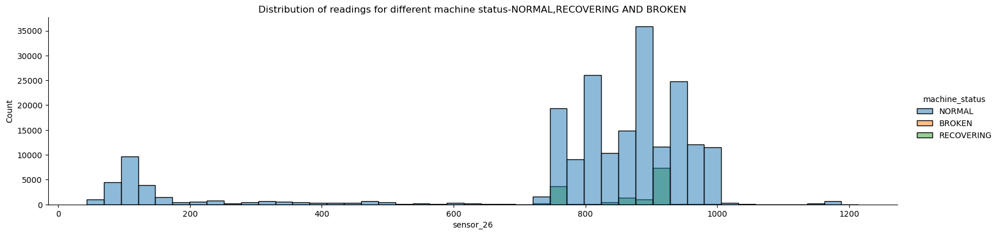

<Figure size 1000x300 with 0 Axes>

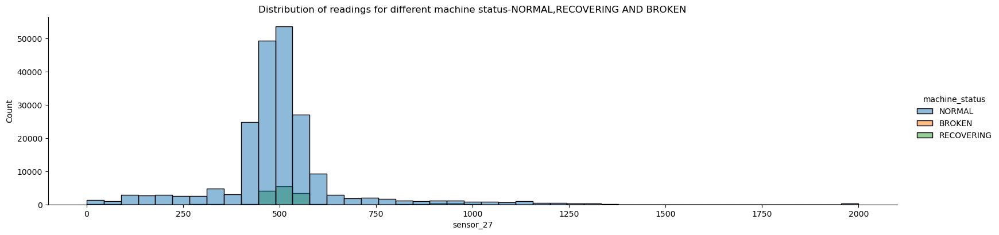

<Figure size 1000x300 with 0 Axes>

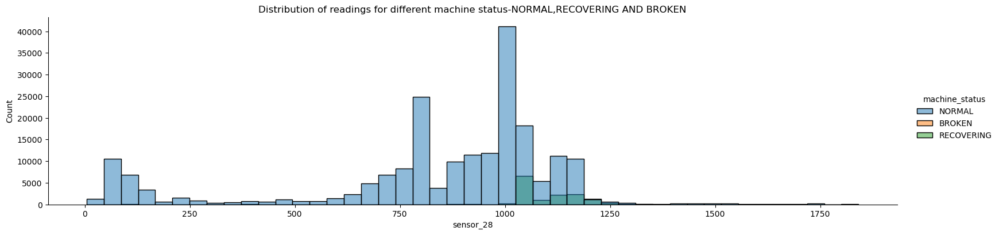

<Figure size 1000x300 with 0 Axes>

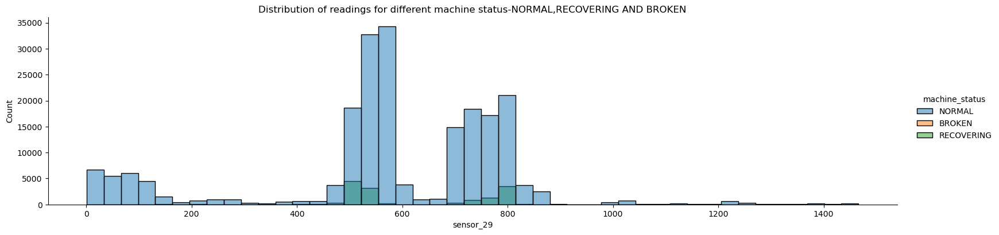

<Figure size 1000x300 with 0 Axes>

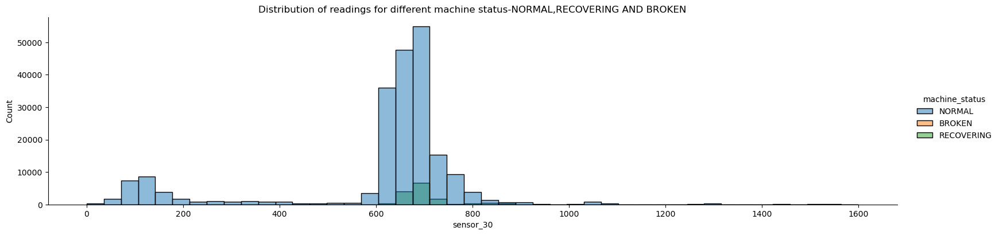

<Figure size 1000x300 with 0 Axes>

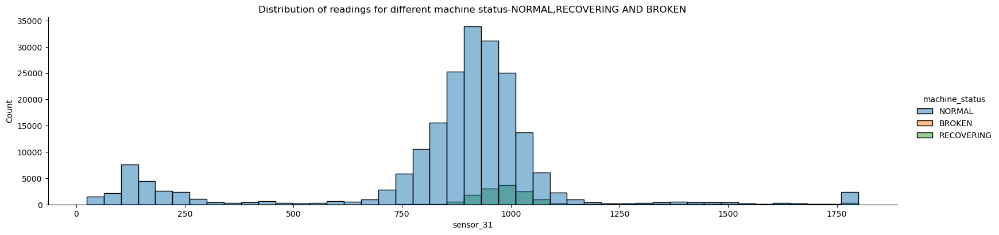

<Figure size 1000x300 with 0 Axes>

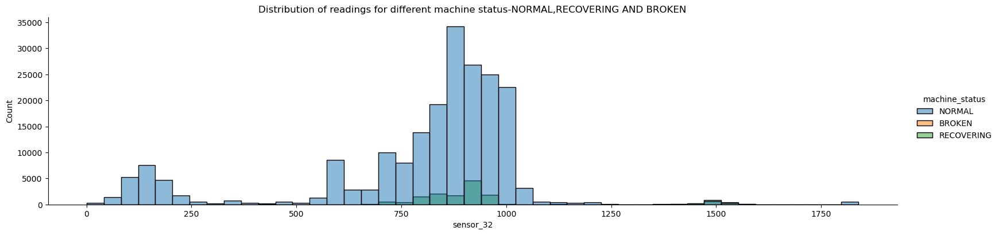

<Figure size 1000x300 with 0 Axes>

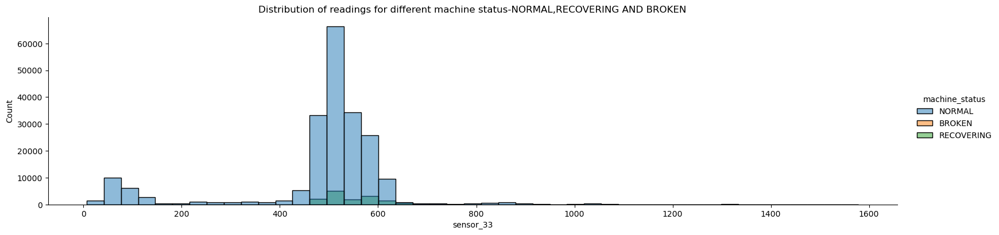

<Figure size 1000x300 with 0 Axes>

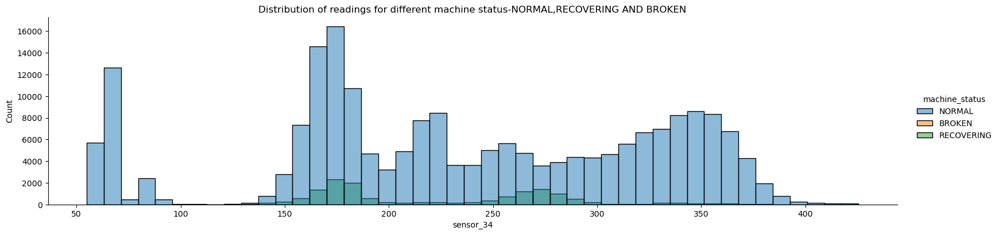

<Figure size 1000x300 with 0 Axes>

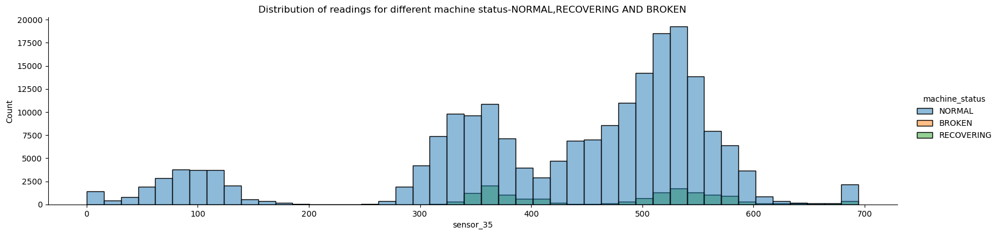

<Figure size 1000x300 with 0 Axes>

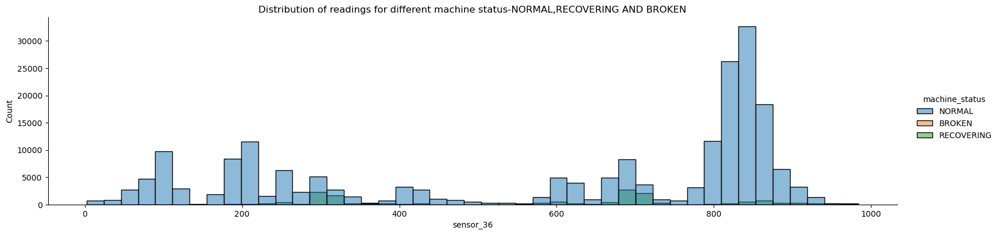

<Figure size 1000x300 with 0 Axes>

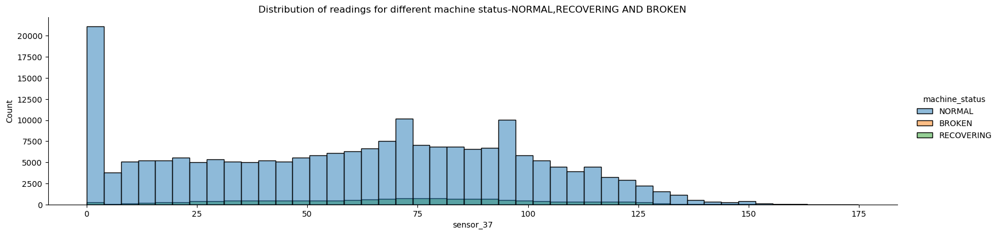

<Figure size 1000x300 with 0 Axes>

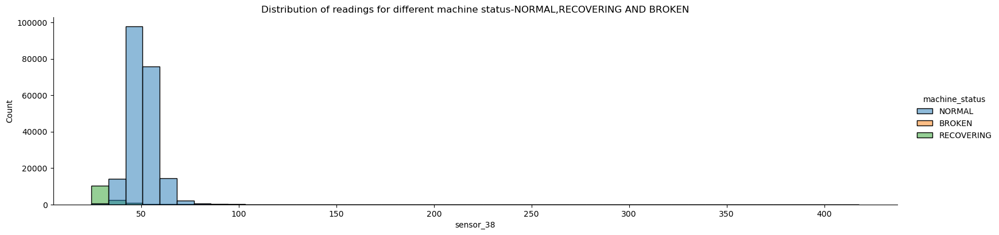

<Figure size 1000x300 with 0 Axes>

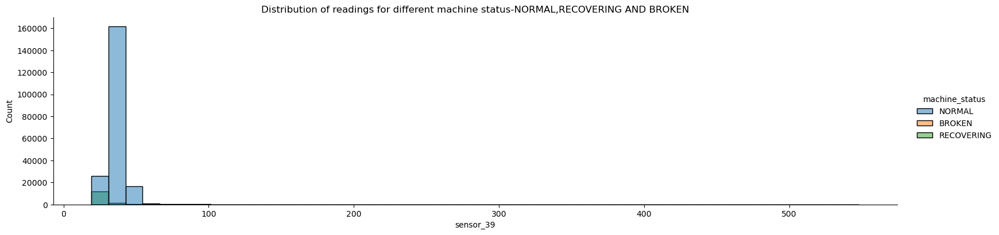

<Figure size 1000x300 with 0 Axes>

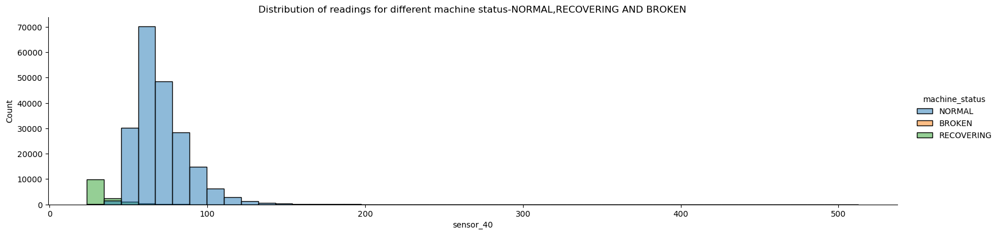

<Figure size 1000x300 with 0 Axes>

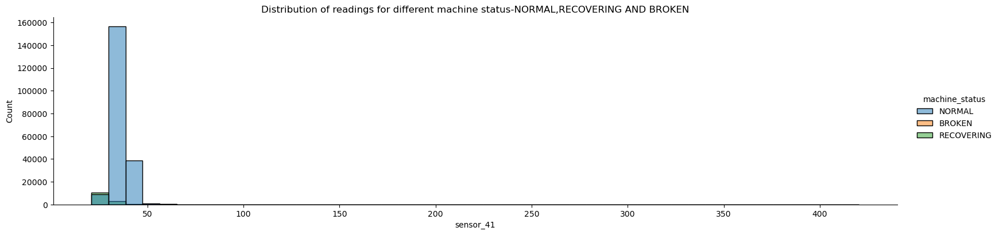

<Figure size 1000x300 with 0 Axes>

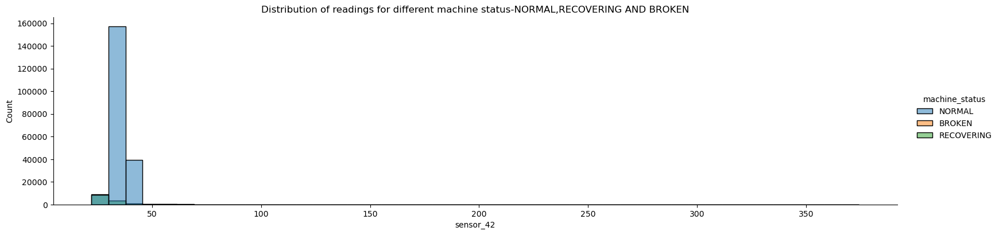

<Figure size 1000x300 with 0 Axes>

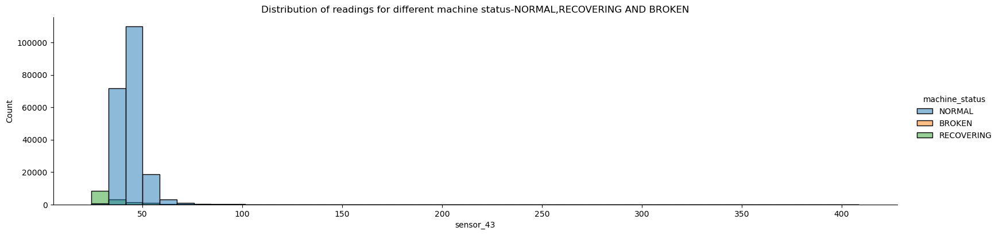

<Figure size 1000x300 with 0 Axes>

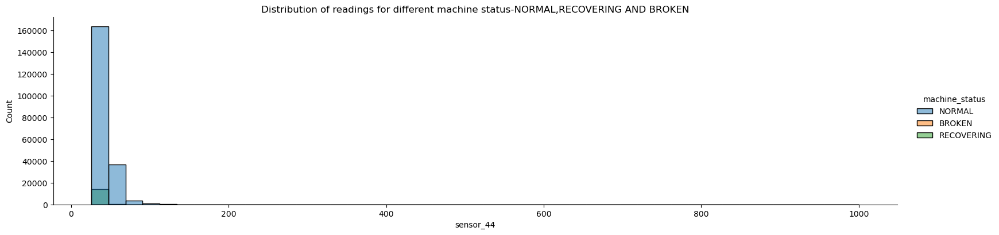

<Figure size 1000x300 with 0 Axes>

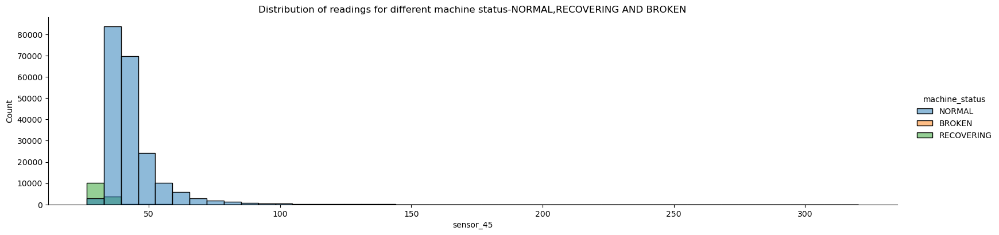

<Figure size 1000x300 with 0 Axes>

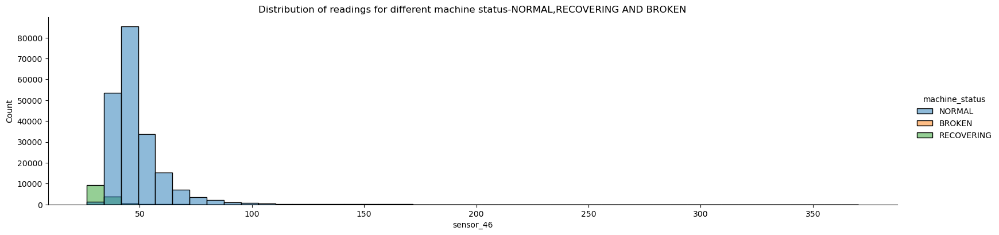

<Figure size 1000x300 with 0 Axes>

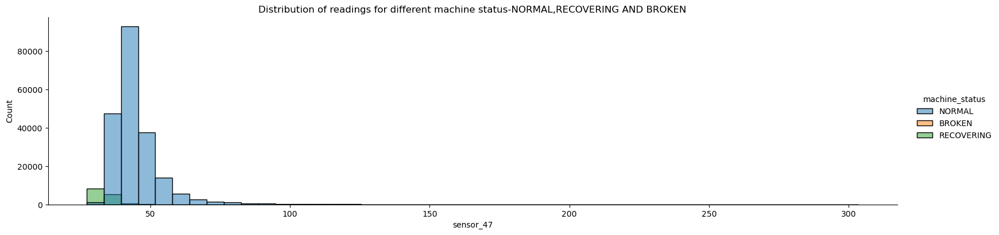

<Figure size 1000x300 with 0 Axes>

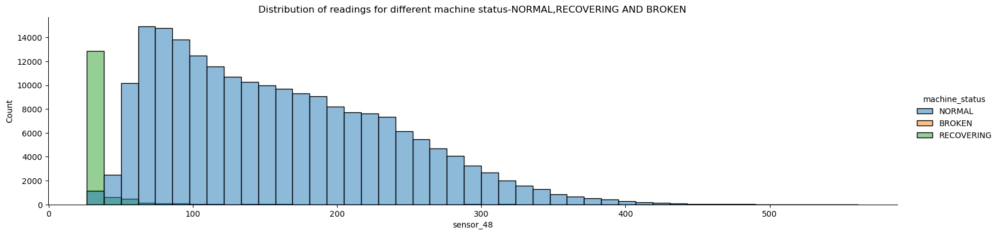

<Figure size 1000x300 with 0 Axes>

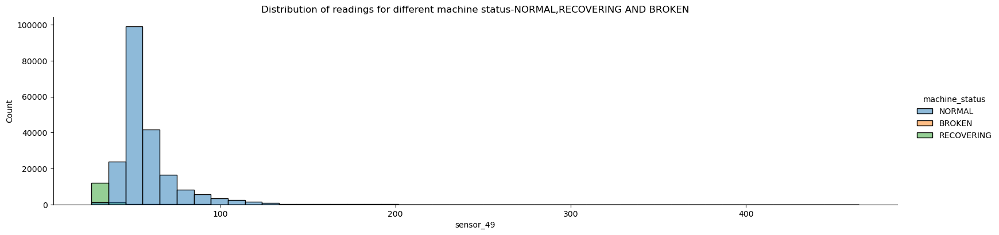

<Figure size 1000x300 with 0 Axes>

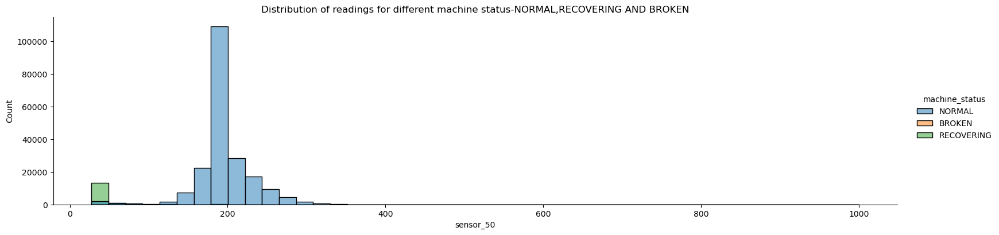

<Figure size 1000x300 with 0 Axes>

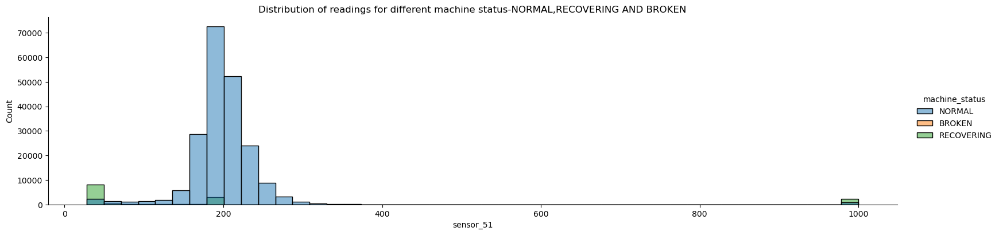

In [176]:
def sensor_machine_status(df,var):
    py.figure(figsize=(10,3))
    s.displot(data=df,x=df[var],hue='machine_status',bins=45,aspect=4,height=4)
    py.title('Distribution of readings for different machine status-NORMAL,RECOVERING AND BROKEN')

for col in names:
    sensor_machine_status(df,col)

<AxesSubplot:xlabel='machine_status', ylabel='count'>

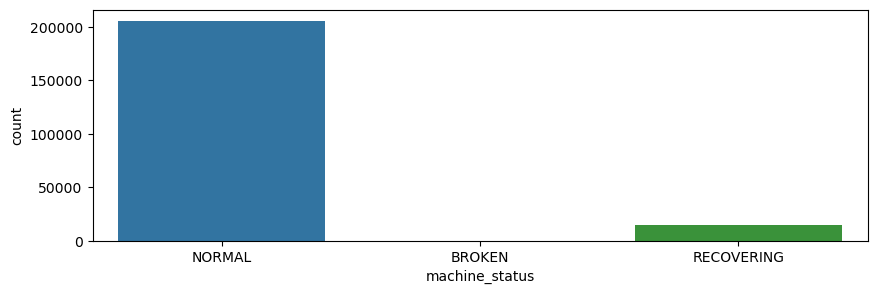

In [148]:
py.figure(figsize=(10,3))
s.countplot(data=df,x='machine_status')

From above it is clear that the dataset contains very less number of reading for sensors on  broken machine 

In [149]:
df[df['machine_status']=='BROKEN']

,sensor_00,sensor_01,sensor_02,sensor_03,sensor_04,sensor_05,sensor_06,sensor_07,sensor_08,sensor_09,...,sensor_43,sensor_44,sensor_45,sensor_46,sensor_47,sensor_48,sensor_49,sensor_50,sensor_51,machine_status
timestamp,,,,,,,,,,,,,,,,,,,,,
2018-12-04 21:55:00,0.000000,53.342010,52.821180,43.402775,202.526031,49.79289,3.219039,16.890910,16.869210,15.082470,...,50.78125,50.92593,51.215280,50.636570,46.006940,409.143500,121.527800,401.909700,324.6528,BROKEN
2018-04-18 00:30:00,1.093982,42.534720,47.699650,41.449650,206.038757,60.30106,12.304690,15.154800,14.185470,13.867190,...,42.70833,34.72222,31.539350,34.432870,33.275460,59.895830,44.560180,177.662000,183.7384,BROKEN
2018-05-19 03:18:00,2.258796,47.265630,52.734370,43.446178,200.115738,66.14643,13.592300,15.914350,15.147570,14.793110,...,39.06250,35.01157,37.905090,39.062500,45.428240,144.675900,49.768520,246.238400,257.5231,BROKEN
2018-05-25 00:30:00,2.321759,47.482640,51.475693,42.795136,612.152800,67.30158,14.062500,16.608800,15.943290,15.596060,...,202.34370,65.68287,57.870370,127.893500,153.935200,155.381900,65.682870,220.196800,267.3611,BROKEN
2018-06-28 22:00:00,0.364005,40.190970,45.225690,40.190971,201.368622,0.00000,11.335360,15.270540,15.183740,15.118630,...,32.29166,28.06713,28.067129,29.513889,29.224537,29.224537,29.513889,32.407406,197.3380,BROKEN
2018-08-07 00:11:00,0.001968,45.138890,52.907990,45.355900,500.000000,1.40131,0.028935,0.036169,0.036169,0.007234,...,36.19791,37.32639,35.300930,38.194440,43.402780,99.537030,44.849540,192.129600,174.7685,BROKEN
2018-07-25 14:00:00,2.318808,45.833332,52.994790,43.880210,420.503448,72.52040,14.185470,16.247110,15.697340,15.053530,...,51.30208,52.10200,52.662040,67.129630,43.981480,230.324100,69.733800,193.865700,205.7292,BROKEN


In [150]:
df = df.reset_index()

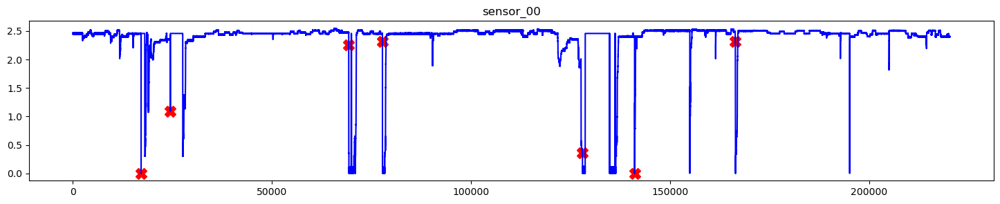

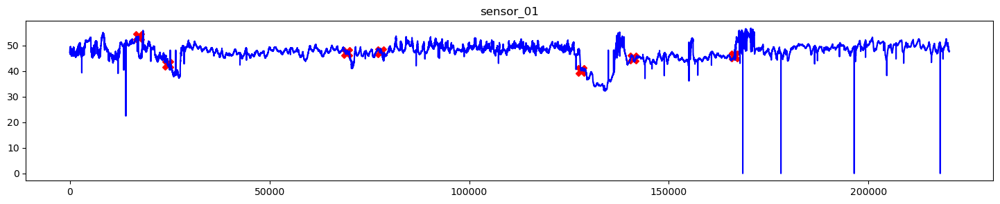

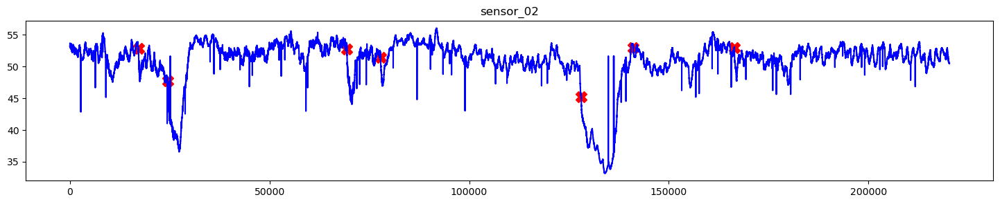

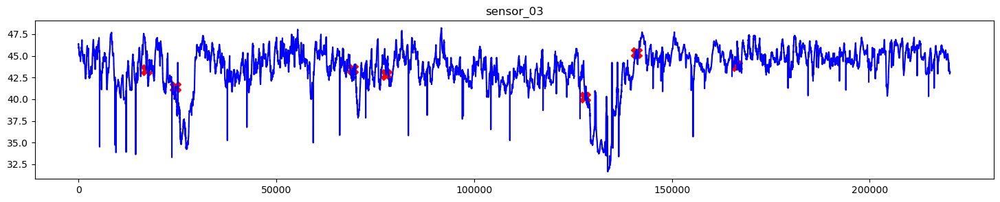

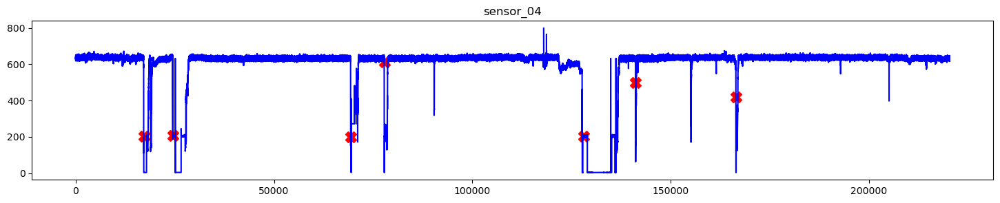

...

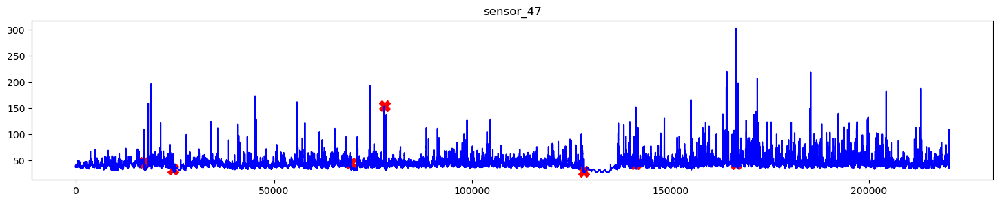

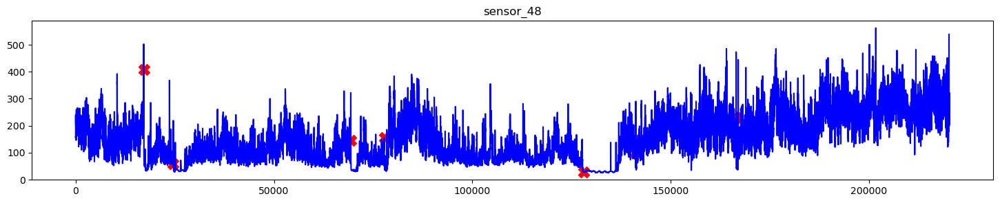

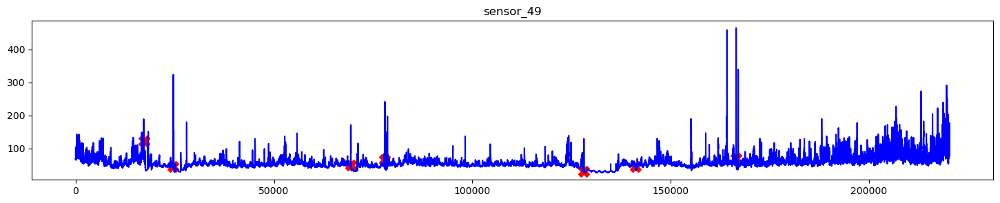

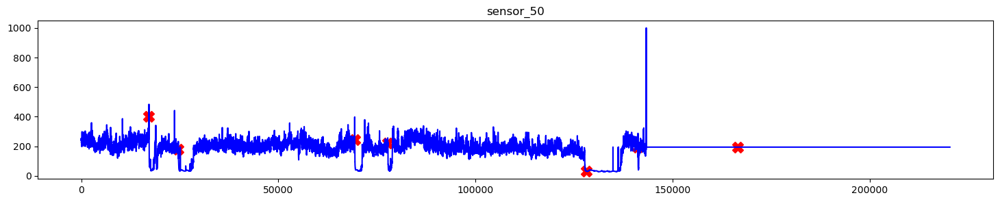

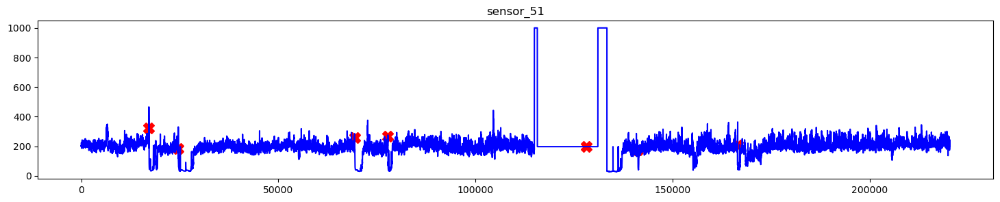

In [151]:
broken = df[df['machine_status']=='BROKEN']
# Plot time series for each sensor with BROKEN state marked with X in red color
for name in names:
    _ = py.figure(figsize=(18,3))
    _ = py.plot(broken[name], linestyle='none', marker='X', color='red', markersize=12)
    _ = py.plot(df[name], color='blue')
    _ = py.title(name)
    py.show()

In [152]:
df['timestamp']

0        2018-01-04 00:00:00
1        2018-01-04 00:01:00
2        2018-01-04 00:02:00
3        2018-01-04 00:03:00
4        2018-01-04 00:04:00
                 ...        
220304   2018-08-31 23:55:00
220305   2018-08-31 23:56:00
220306   2018-08-31 23:57:00
220307   2018-08-31 23:58:00
220308   2018-08-31 23:59:00
Name: timestamp, Length: 220309, dtype: datetime64[ns]

In [153]:
df['day'] = df['timestamp'].dt.day

In [154]:
df['month'] = df['timestamp'].dt.month

In [155]:
df['hour'] = df['timestamp'].dt.hour

In [156]:
# df['year'] = df['timestamp'].dt.year # but it only contains data for the year of 2018

Month Analysis

In [157]:
#to know the behaviour of each sensor for 12 months
def behav_each_sensor_12_months(df,var):
    for i in range(1,13):
        df_month = df[df['month']==i]
        s.displot(data=df_month,x=var,kde=True,aspect=6,height=2)
        py.title('month_' + str(i))

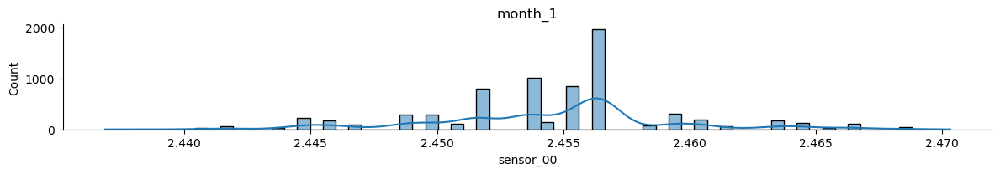

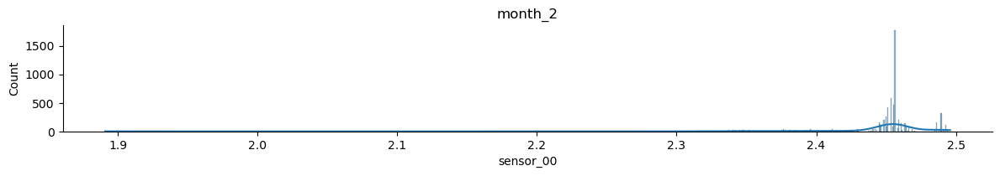

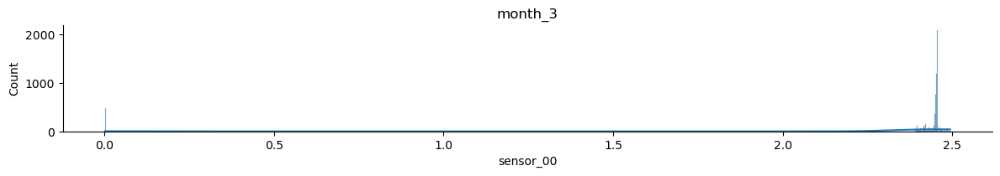

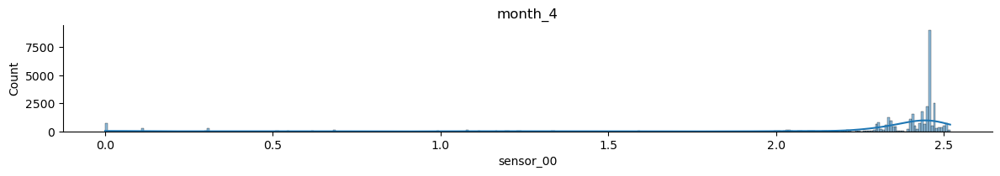

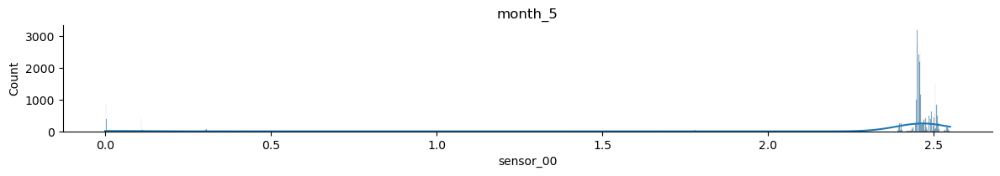

...

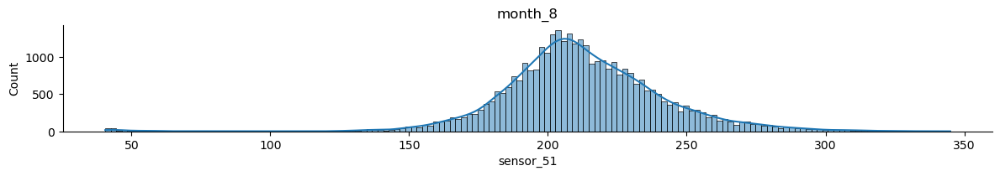

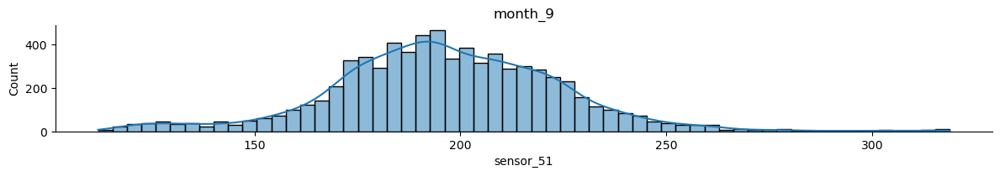

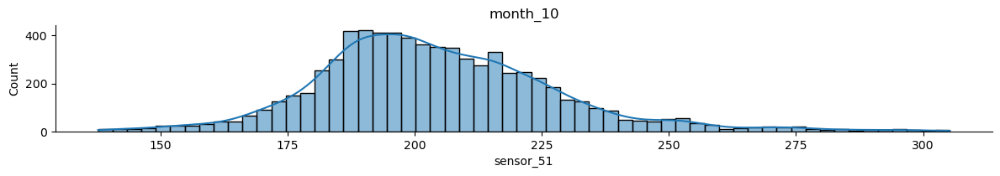

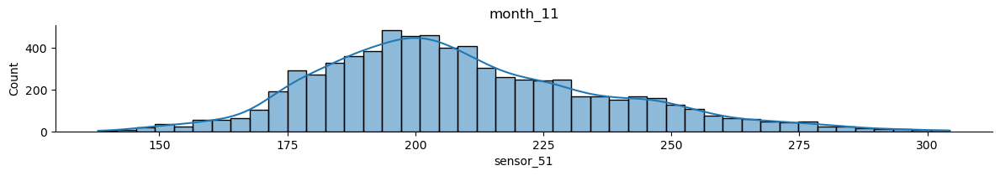

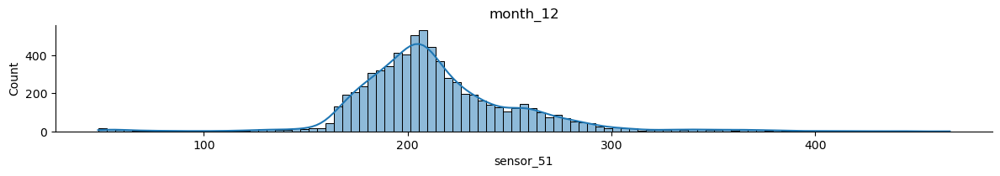

In [158]:
#passing sensors for to analyse the the distibution of readings
for cols in names:
    behav_each_sensor_12_months(df,cols)

# SETTING TIMESTAMP AS INDEX

In [159]:
df = df.set_index('timestamp',drop=True)

In [160]:
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 220309 entries, 2018-01-04 00:00:00 to 2018-08-31 23:59:00
Data columns (total 55 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   sensor_00       220309 non-null  float64
 1   sensor_01       220309 non-null  float64
 2   sensor_02       220309 non-null  float64
 3   sensor_03       220309 non-null  float64
 4   sensor_04       220309 non-null  float64
 5   sensor_05       220309 non-null  float64
 6   sensor_06       220309 non-null  float64
 7   sensor_07       220309 non-null  float64
 8   sensor_08       220309 non-null  float64
 9   sensor_09       220309 non-null  float64
 10  sensor_10       220309 non-null  float64
 11  sensor_11       220309 non-null  float64
 12  sensor_12       220309 non-null  float64
 13  sensor_13       220309 non-null  float64
 14  sensor_14       220309 non-null  float64
 15  sensor_16       220309 non-null  float64
 16  sensor_17       220309

Day analysis

In [163]:
df['day'].unique()

array([ 4, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28,
       29, 30,  5, 31,  6,  7,  8], dtype=int64)

In [164]:
df2 = df.loc['2018-01-04']

In [165]:
df2

,sensor_00,sensor_01,sensor_02,sensor_03,sensor_04,sensor_05,sensor_06,sensor_07,sensor_08,sensor_09,...,sensor_46,sensor_47,sensor_48,sensor_49,sensor_50,sensor_51,machine_status,day,month,hour
timestamp,,,,,,,,,,,,,,,,,,,,,
2018-01-04 00:00:00,2.465394,47.09201,53.21180,46.310760,634.3750,76.45975,13.41146,16.13136,15.56713,15.05353,...,50.925930,38.194440,157.9861,67.70834,243.0556,201.3889,NORMAL,4,1,0
2018-01-04 00:01:00,2.465394,47.09201,53.21180,46.310760,634.3750,76.45975,13.41146,16.13136,15.56713,15.05353,...,50.925930,38.194440,157.9861,67.70834,243.0556,201.3889,NORMAL,4,1,0
2018-01-04 00:02:00,2.444734,47.35243,53.21180,46.397570,638.8889,73.54598,13.32465,16.03733,15.61777,15.01013,...,51.215280,38.194443,155.9606,67.12963,241.3194,203.7037,NORMAL,4,1,0
2018-01-04 00:03:00,2.460474,47.09201,53.16840,46.397568,628.1250,76.98898,13.31742,16.24711,15.69734,15.08247,...,51.215280,38.194440,155.9606,66.84028,240.4514,203.1250,NORMAL,4,1,0
2018-01-04 00:04:00,2.445718,47.13541,53.21180,46.397568,636.4583,76.58897,13.35359,16.21094,15.69734,15.08247,...,51.793980,38.773150,158.2755,66.55093,242.1875,201.3889,NORMAL,4,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2018-01-04 23:55:00,2.445718,45.83333,52.34375,44.748260,625.8102,80.48779,13.09317,16.16753,15.41522,15.08247,...,36.458330,36.458332,181.4236,80.15046,228.2986,225.9838,NORMAL,4,1,23
2018-01-04 23:56:00,2.463426,45.83333,52.30035,44.791660,635.1852,81.48790,12.99913,16.16030,15.65393,15.08247,...,36.458330,36.458332,178.5301,80.15046,225.6944,221.9329,NORMAL,4,1,23
2018-01-04 23:57:00,2.441782,45.78993,52.30035,44.791664,646.9907,78.59231,13.12211,16.12413,15.65393,15.08247,...,36.747680,36.458330,175.6366,80.72916,224.5370,219.0394,NORMAL,4,1,23


In [167]:
df2 = df2.drop(['day', 'month', 'hour'],axis=1)

In [168]:
df1.columns

Index(['sensor_00', 'sensor_01', 'sensor_02', 'sensor_03', 'sensor_04',
       'sensor_05', 'sensor_06', 'sensor_07', 'sensor_08', 'sensor_09',
       'sensor_10', 'sensor_11', 'sensor_12', 'sensor_13', 'sensor_14',
       'sensor_16', 'sensor_17', 'sensor_18', 'sensor_19', 'sensor_20',
       'sensor_21', 'sensor_22', 'sensor_23', 'sensor_24', 'sensor_25',
       'sensor_26', 'sensor_27', 'sensor_28', 'sensor_29', 'sensor_30',
       'sensor_31', 'sensor_32', 'sensor_33', 'sensor_34', 'sensor_35',
       'sensor_36', 'sensor_37', 'sensor_38', 'sensor_39', 'sensor_40',
       'sensor_41', 'sensor_42', 'sensor_43', 'sensor_44', 'sensor_45',
       'sensor_46', 'sensor_47', 'sensor_48', 'sensor_49', 'sensor_50',
       'sensor_51'],
      dtype='object')

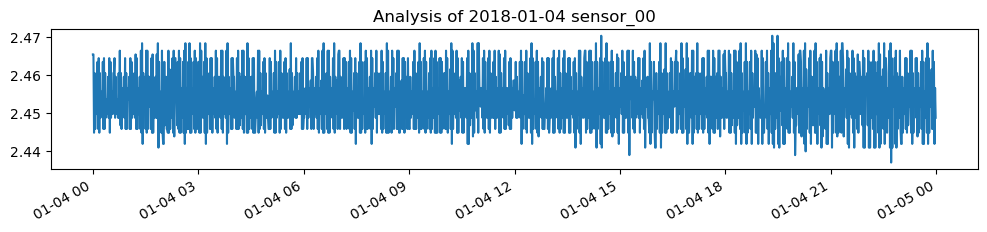

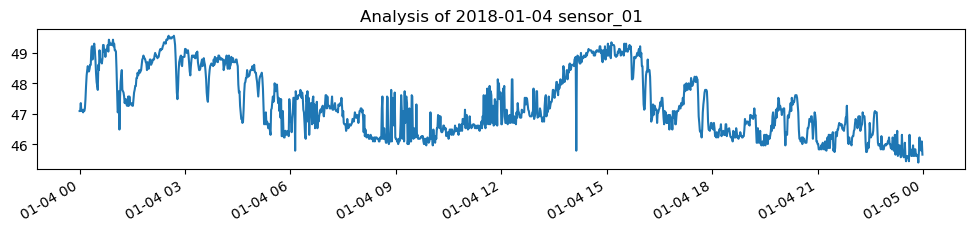

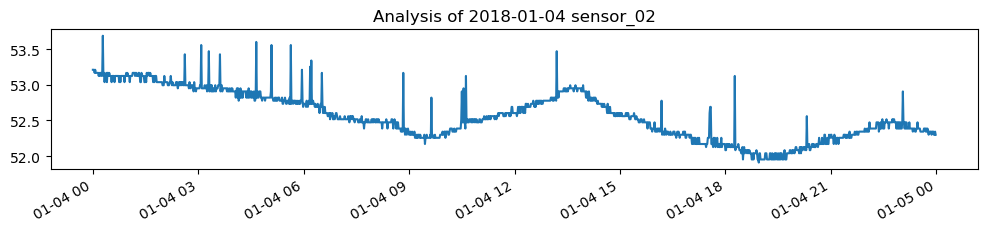

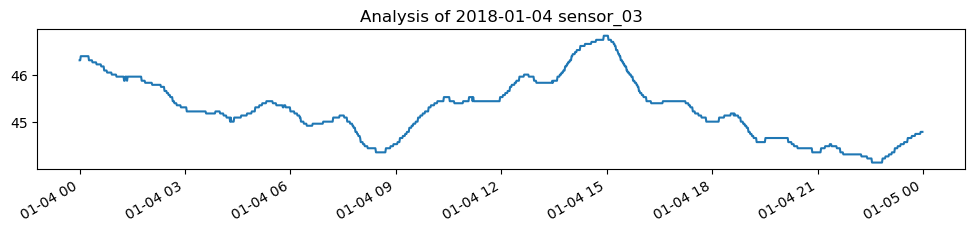

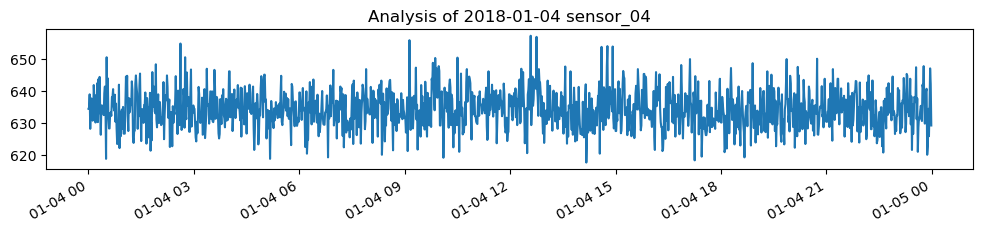

...

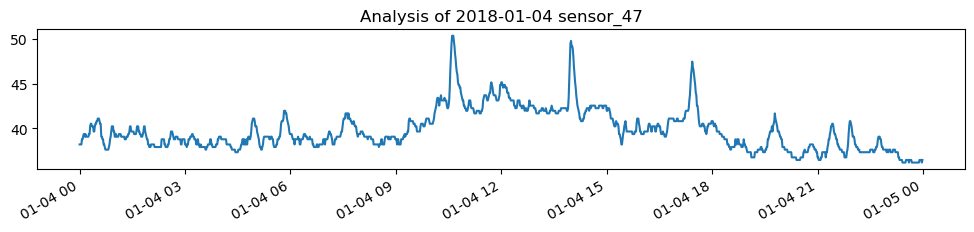

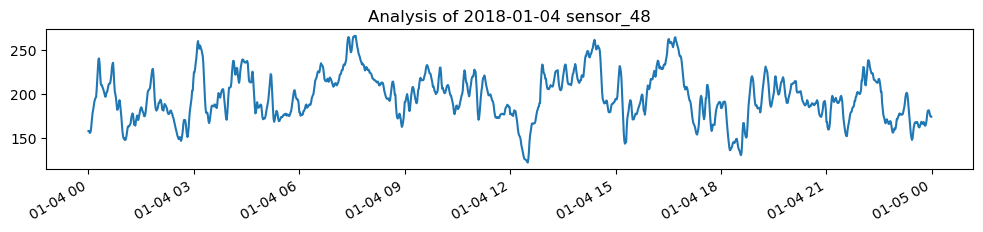

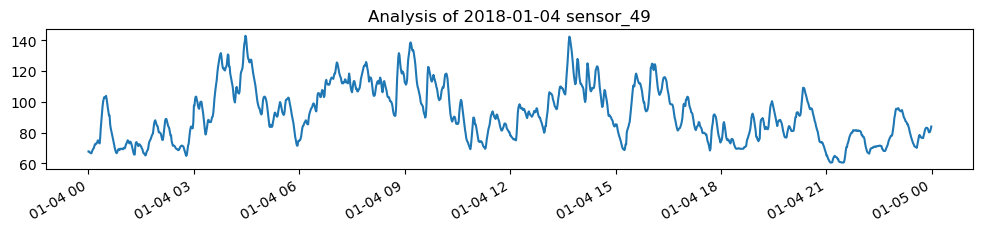

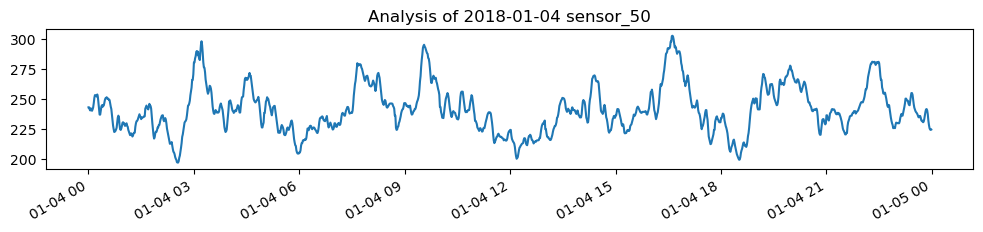

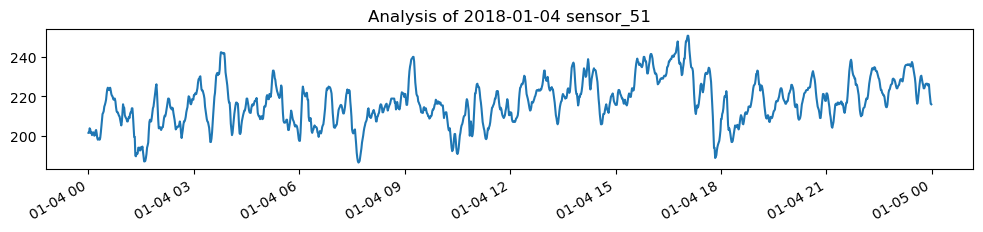

In [169]:
cols = df1.columns
for col in cols:
    figure,axis=py.subplots(figsize=(10, 2))
    py.tight_layout()
    figure.autofmt_xdate() 
    axis.plot(df2.index,df2[col])
    py.title(f'Analysis of 2018-01-04 {col}')

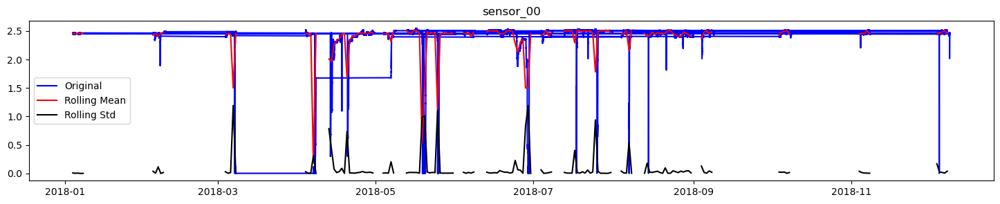

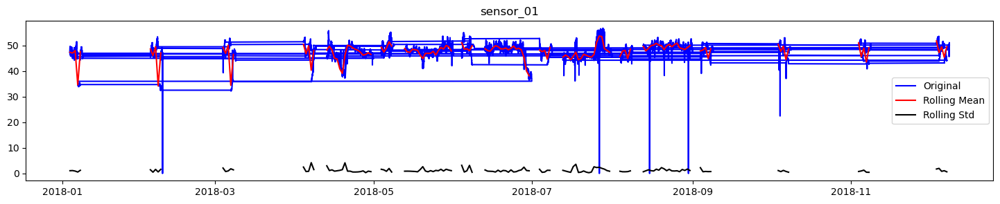

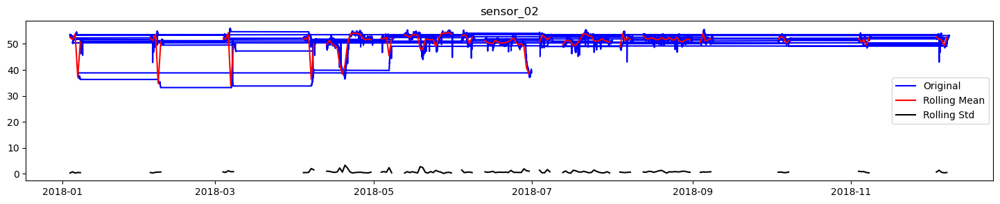

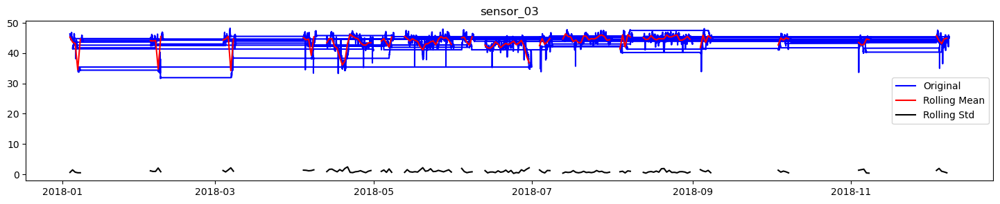

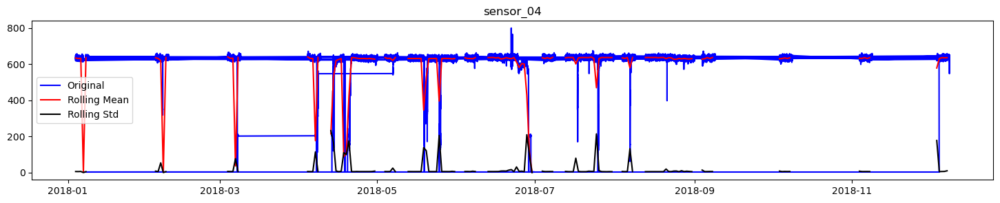

...

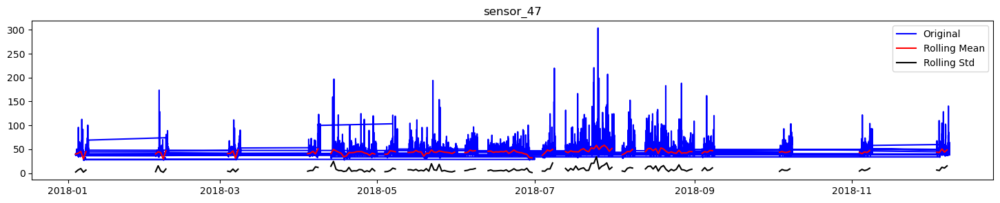

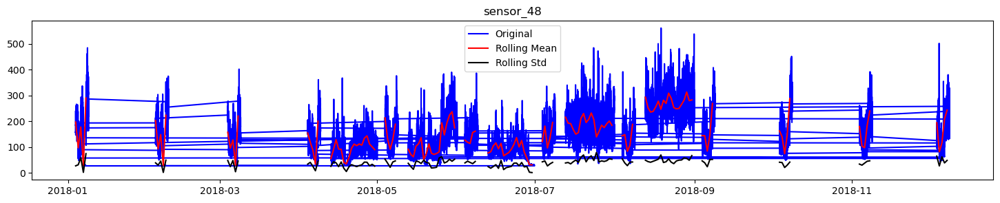

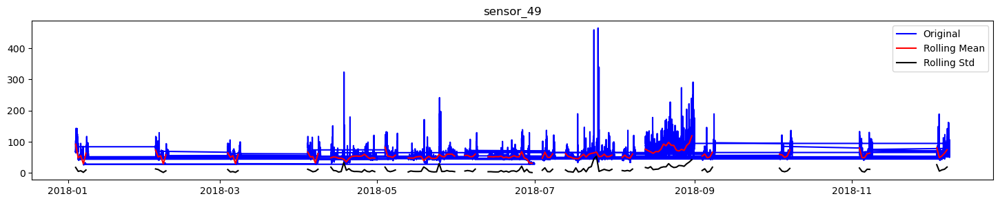

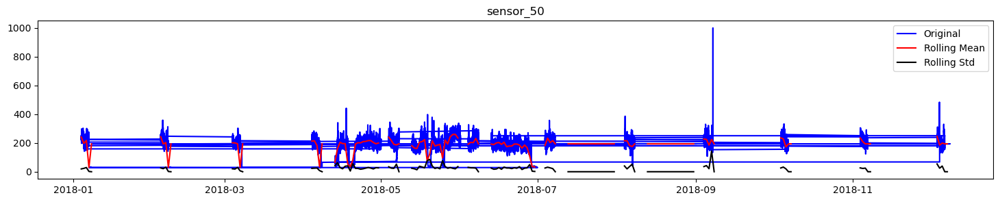

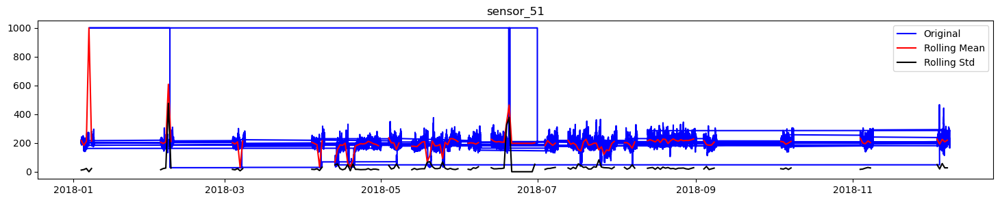

In [170]:
# Resample the entire dataset by daily average
rollmean = df.resample(rule='D').mean()
rollstd = df.resample(rule='D').std()
names=df1.columns
for name in names:
    _ = py.figure(figsize=(18,3))
    _ = py.plot(df[name], color='blue', label='Original')
    _ = py.plot(rollmean[name], color='red', label='Rolling Mean')
    _ = py.plot(rollstd[name], color='black', label='Rolling Std' )
    _ = py.legend(loc='best')
    _ = py.title(name)
    py.show()

# SCALING AND PCA

In [171]:
from sklearn.preprocessing import StandardScaler 
from sklearn.decomposition import PCA
from sklearn.pipeline import Pipeline
steps = [('scaler', StandardScaler()), ('Pca', PCA())]

X = df.drop('machine_status',axis=1)

In [172]:
pipeline = Pipeline(steps)

In [173]:
pipeline.fit(X)

Pipeline(steps=[('scaler', StandardScaler()), ('Pca', PCA())])

Text(0.5, 1.0, 'Importance of the Principal Components')

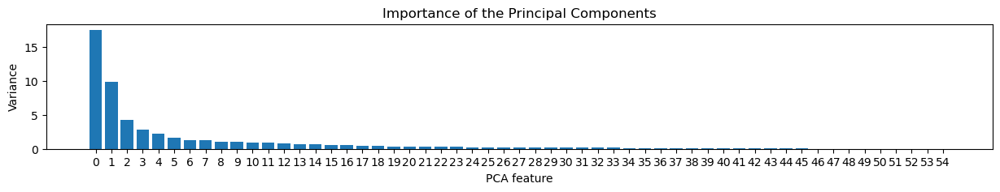

In [61]:
features = range(pipeline['Pca'].n_components_)
py.figure(figsize=(15,2))
py.bar(features, pipeline['Pca'].explained_variance_)
py.xlabel('PCA feature')
py.ylabel('Variance')
py.xticks(features)
py.title("Importance of the Principal Components")


From the graph it is clear that the first two components have highest variance


In [62]:
pca = PCA(n_components=2)

In [63]:
features = pca.fit_transform(X)

In [64]:
df_new = p.DataFrame(data=features,columns=['f1','f2'])

In [65]:
df_new.head()

,f1,f2
0,69.873712,264.820910
1,69.873712,264.820910
2,28.193215,282.591195
3,24.899008,289.376369
4,29.978679,293.750500


# KMEANS CLUSTERING

In [99]:
X = df_new.values

Text(0.5, 1.0, 'Elbow Techique')

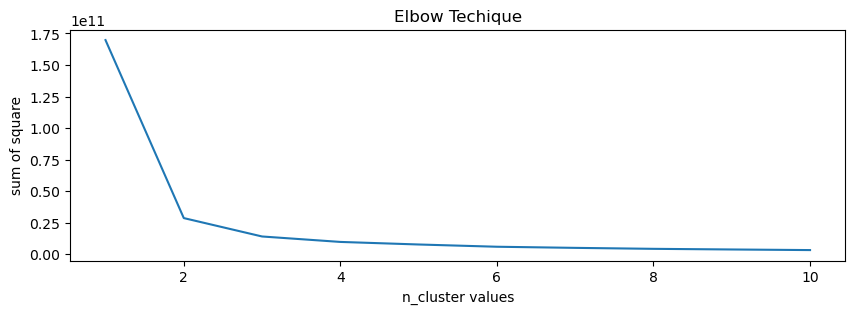

In [102]:
wcss = []
for i in range(1,11):
    kmean = KMeans(n_clusters=i,init='k-means++',random_state=0)
    kmean.fit(X)
    wcss.append(kmean.inertia_)
py.figure(figsize=(10,3))
py.plot(range(1,11),wcss)
py.xlabel('n_cluster values')
py.ylabel('sum of square')
py.title('Elbow Techique')

In [106]:
kmeans = KMeans(n_clusters=3,random_state=10)
labels = kmeans.fit_predict(X)

#Want to validate whether n_cluster = 3 is valid or not basis of silhouette score

For n_cluster = 2 average silhouette score is 0.8394476337218127
For n_cluster = 3 average silhouette score is 0.6564107133366294
For n_cluster = 4 average silhouette score is 0.6645335407113893
For n_cluster = 5 average silhouette score is 0.6701673535664865
For n_cluster = 6 average silhouette score is 0.5092728553702162


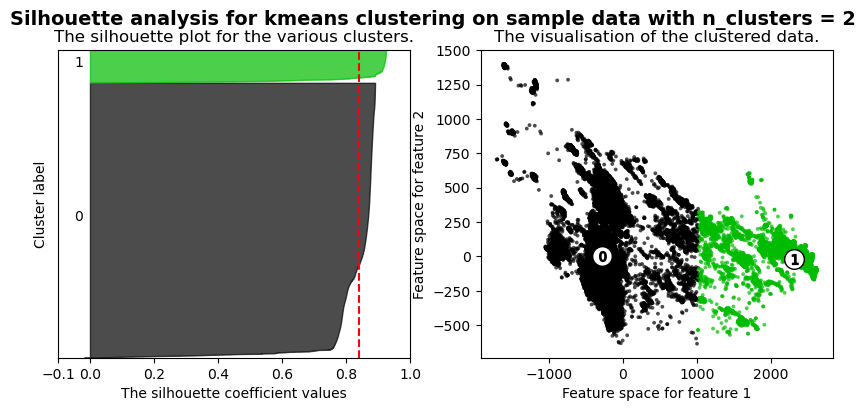

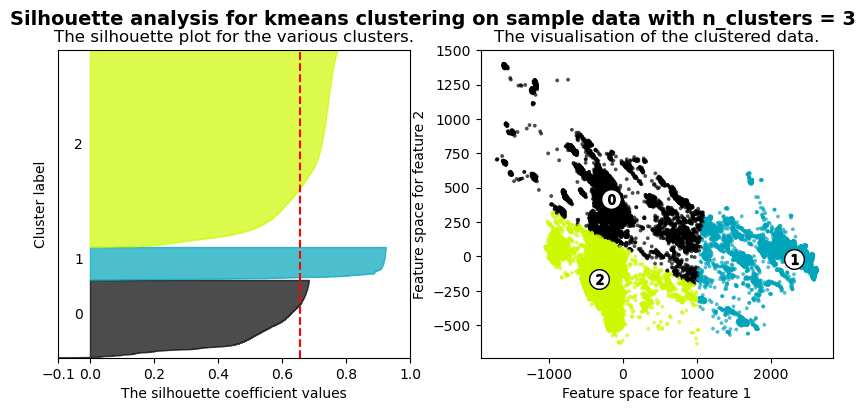

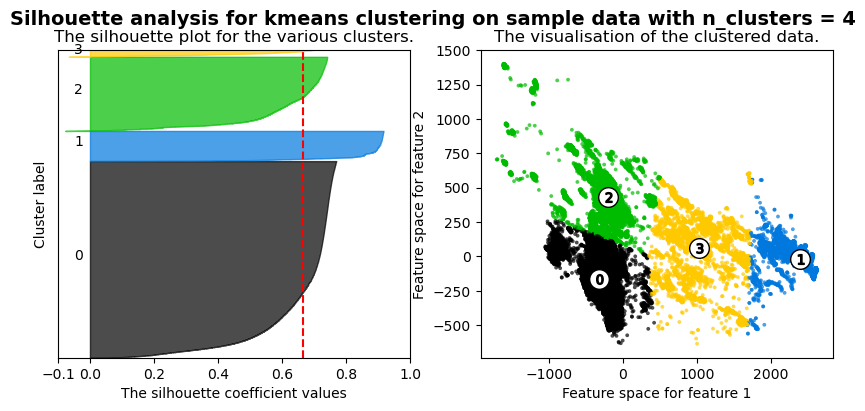

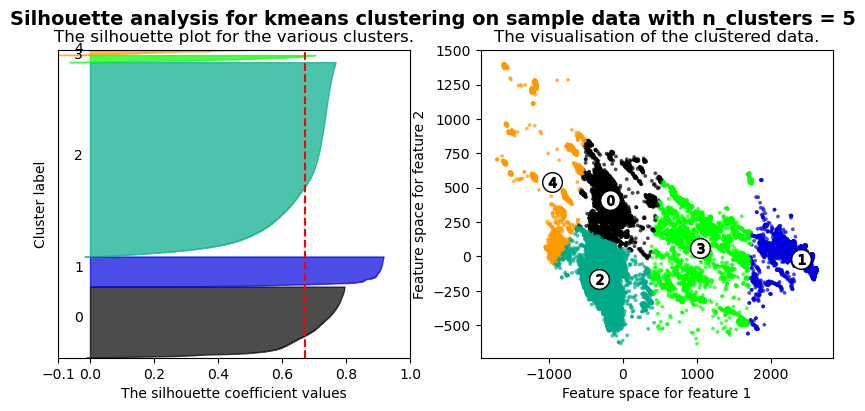

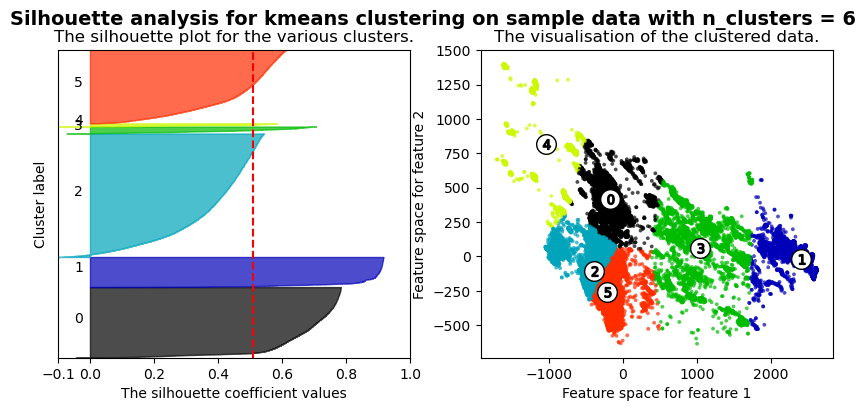

In [104]:
n_clusters = [2,3,4,5,6]

for ncls in n_clusters:
    fig,(ax1,ax2) = py.subplots(1,2)
    fig.set_size_inches(10,4)
    ax1.set_xlim([-0.1,1])
    ax1.set_ylim([0,len(X)+(ncls+1)*10])
    cluster = KMeans(n_clusters=ncls,random_state=10)
    cluster_labels = cluster.fit_predict(X)
    silhouette_avg = silhouette_score(X,cluster_labels)
    print(f'For n_cluster = {ncls} average silhouette score is {silhouette_avg}')
    sample_silhouette_values = silhouette_samples(X,cluster_labels)
    
    y_lower = 10
    for i in range(ncls):
        ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels==i]
        
        ith_cluster_silhouette_values.sort()
        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i
        
        color = cm.nipy_spectral(float(i)/ncls)
        ax1.fill_betweenx(np.arange(y_lower,y_upper),
                        0,ith_cluster_silhouette_values,
                        facecolor=color,edgecolor=color,alpha=0.7)
        ax1.text(-0.05,y_lower+0.5*size_cluster_i,str(i))
        y_lower = y_upper + 10 
    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")
    
    ax1.axvline(x=silhouette_avg,color='red',linestyle='--')
    ax1.set_yticks([])
    ax1.set_xticks([-0.1,0,0.2,0.4,0.6,0.8,1])
    
    colors = cm.nipy_spectral(cluster_labels.astype(float)/ncls)
    ax2.scatter(X[:,0],X[:,1],marker='.',s=30,lw=0,alpha=0.7,c=colors,edgecolor='k')
    centers = cluster.cluster_centers_
    ax2.scatter(centers[:,0],centers[:,1],marker='o',s=200,alpha=1,c='white',edgecolor='k')
    
    for i,c in enumerate(centers):
        ax2.scatter(c[0],c[1],marker='$%d$' % i,alpha=1,s=50,edgecolor='k')
        
    ax2.set_title("The visualisation of the clustered data.")
    ax2.set_xlabel('Feature space for feature 1')
    ax2.set_ylabel('Feature space for feature 2')
    
    py.suptitle(("Silhouette analysis for kmeans clustering on sample data "
               "with n_clusters = %d" %ncls),
                fontsize=14,fontweight = 'bold')
py.show()

From the above result, we can see that for n_cluster = 3, there is no negative value from the plot on the L.H.S, also from elbow method got the same result

So will continue with 3 clusters

In [107]:
kmeans = KMeans(n_clusters=3, random_state=10)
kmeans.fit(df_new)
labels = kmeans.predict(df_new)
unique_elements, counts_elements = np.unique(labels, return_counts=True)
clusters = np.asarray((unique_elements, counts_elements))

def getDistanceByPoint(data, model):
    distance = []
    for i in range(0,len(data)):
        Xa = np.array(data.loc[i])
        Xb = model.cluster_centers_[model.labels_[i]-1]
        distance.append(np.linalg.norm(Xa-Xb))
    return p.Series(distance, index=data.index)
outliers_fraction = 0.13

distance = getDistanceByPoint(df_new, kmeans)

number_of_outliers = int(outliers_fraction*len(distance))

threshold = distance.nlargest(number_of_outliers).min()

df_new['anomaly1'] = (distance >= threshold).astype(int)

In [112]:
df_new['anomaly1'].unique()

array([0, 1])

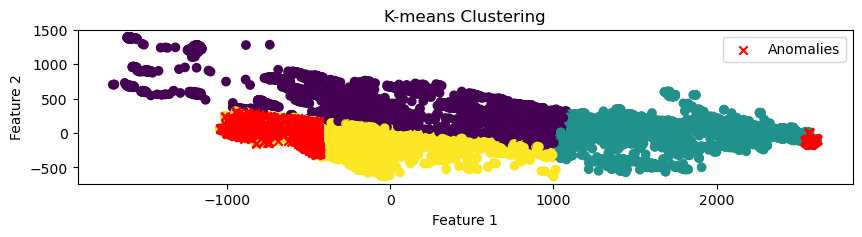

In [113]:
py.figure(figsize=(10,2))
py.scatter(df_new['f1'], df_new['f2'], c=labels, cmap='viridis')
py.xlabel('Feature 1')
py.ylabel('Feature 2')
py.title('K-means Clustering')

anomaly_indices = df_new[df_new['anomaly1'] == 1].index
py.scatter(df_new.loc[anomaly_indices, 'f1'], df_new.loc[anomaly_indices, 'f2'],
            c='red', marker='x', label='Anomalies')

py.legend()
py.show()

ISOLATION FOREST

In [96]:
def Isolation_forest(df,var): 
    outliers_fraction = 0.13
    model =  IsolationForest(contamination=outliers_fraction)
    model.fit(X) 
    df_new['anomaly2'] = p.Series(model.predict(X))
    # visualization
    df['anomaly2'] = p.Series(df_new['anomaly2'].values, index=df.index)
    a = df.loc[df['anomaly2'] == -1] #anomaly
    _ = py.figure(figsize=(18,6))
    _ = py.plot(df[var], color='blue', label='Normal')
    _ = py.plot(a[var], linestyle='none', marker='X', color='red', markersize=12, label='Anomaly')
    _ = py.xlabel('Date and Time')
    _ = py.ylabel('Sensor Reading')
    _ = py.title('Sensor_51 Anomalies')
    _ = py.legend(loc='best')
    py.show()

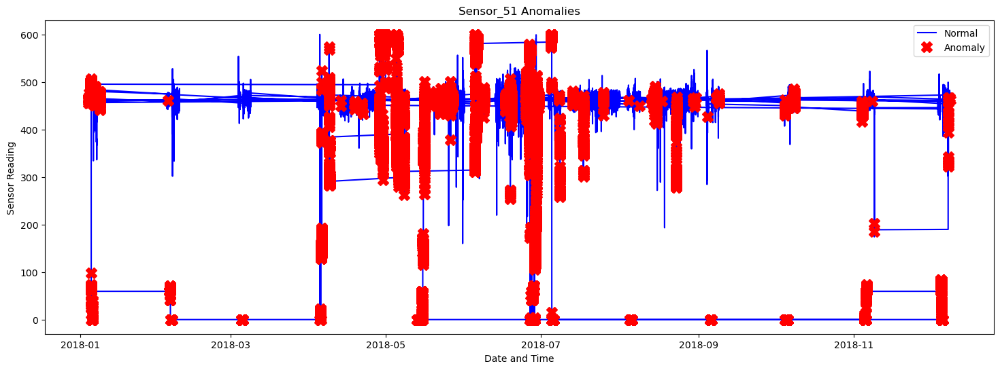

In [98]:
Isolation_forest(df,'sensor_17')